In [27]:
# Import dependencies
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
from scipy.stats import boxcox

import missingno as msno
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from sklearn.feature_selection import VarianceThreshold

import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_rows', 500)

In [3]:
# data import
data = pd.read_csv("C:/Projects/2021/16_practice/multinomial_classification/data/data.csv")
data["target"] = data.target.astype('category')

# Target Analysis

Check if target has class imbalances and by what proportions does the imbalances occur. 

In [4]:
pd.DataFrame(data.target.value_counts(normalize=True))

,target
0,0.976467
1,0.009862
2,0.005761
3,0.005078
4,0.002832


,target
0,0.976467
1,0.009862
2,0.005761
3,0.005078
4,0.002832


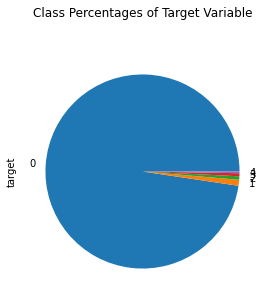

In [5]:
display(pd.DataFrame(data.target.value_counts(normalize=True)))

plt.figure(figsize=(8, 4))
data.target.value_counts(normalize=True).plot.pie()
plt.suptitle("Class Percentages of Target Variable", y = 1.03, size = 12)
plt.tight_layout()

# Outlier Analysis

In [6]:
X = data.loc[:, ~data.columns.isin(['target'])].values
y = data.loc[:,['target']].values
X = pd.DataFrame(StandardScaler().fit_transform(X))
normalized_data= pd.concat([X,pd.DataFrame(y)], axis=1)

In [7]:
X.shape

(10241, 151)

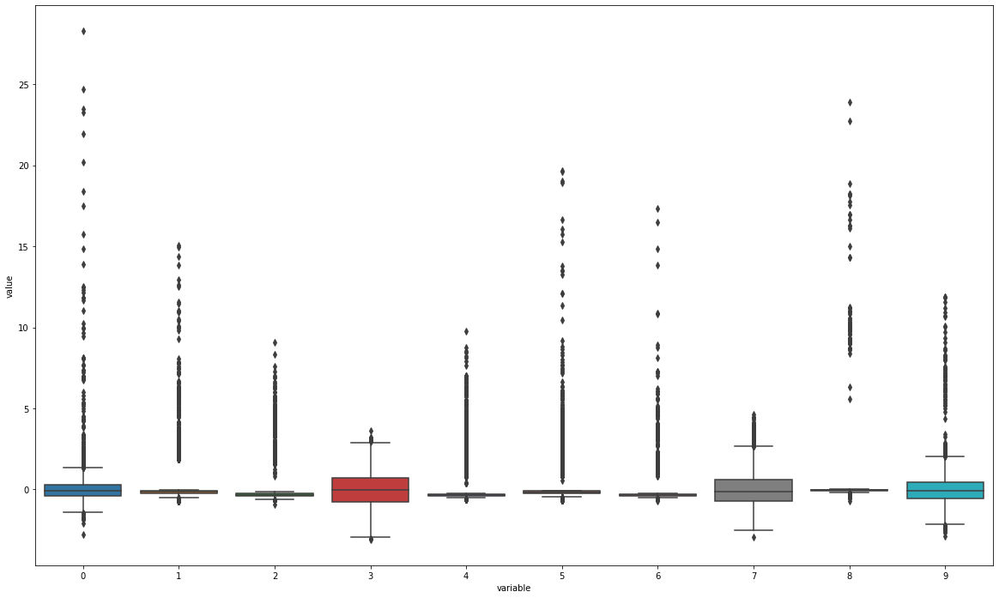

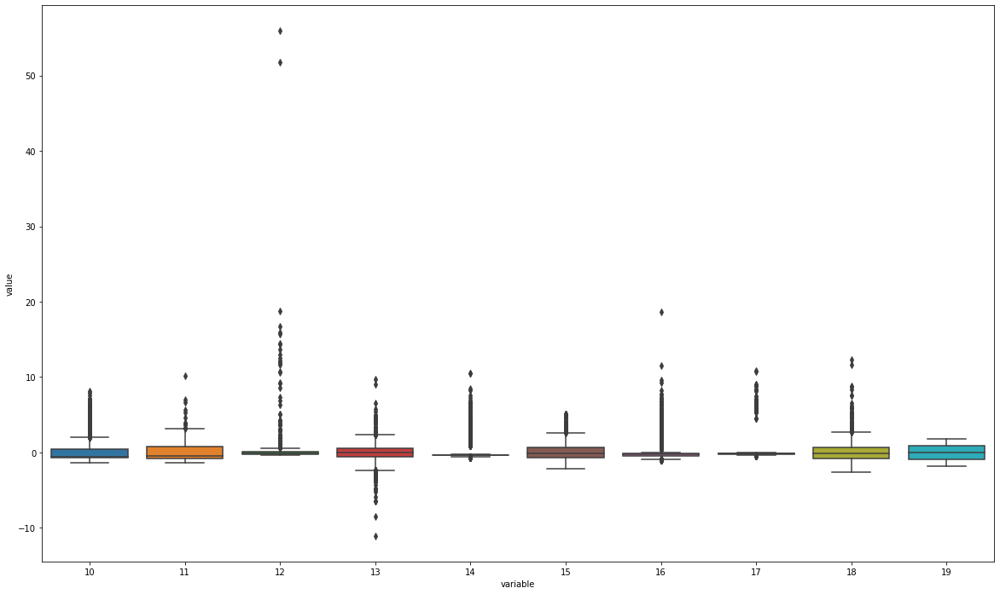

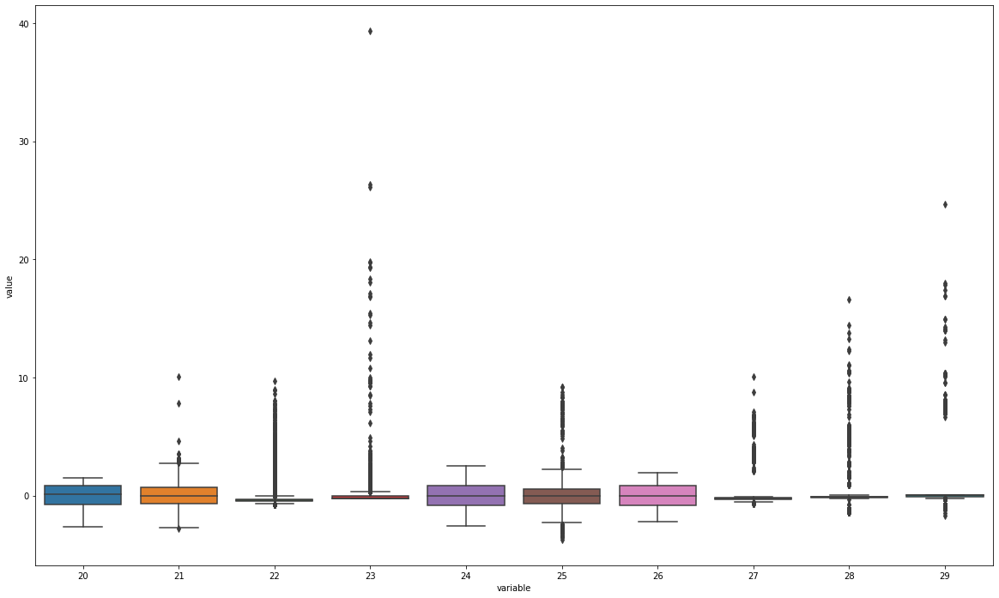

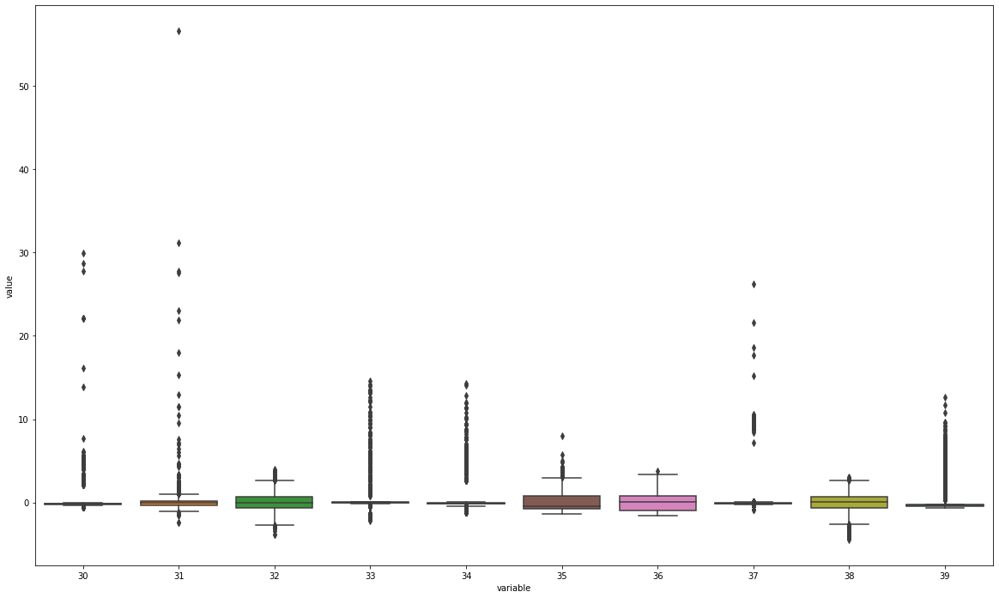

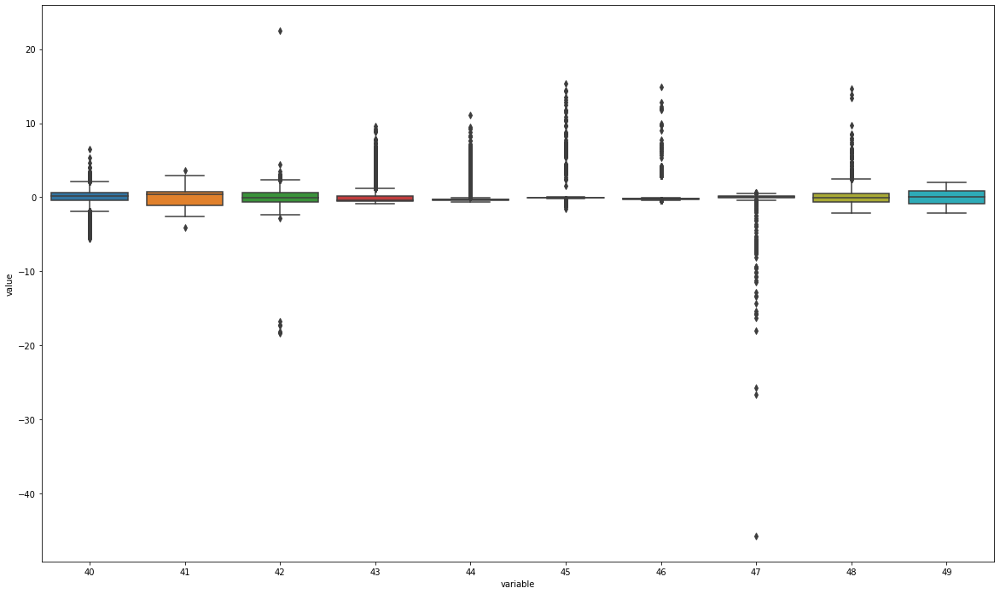

...

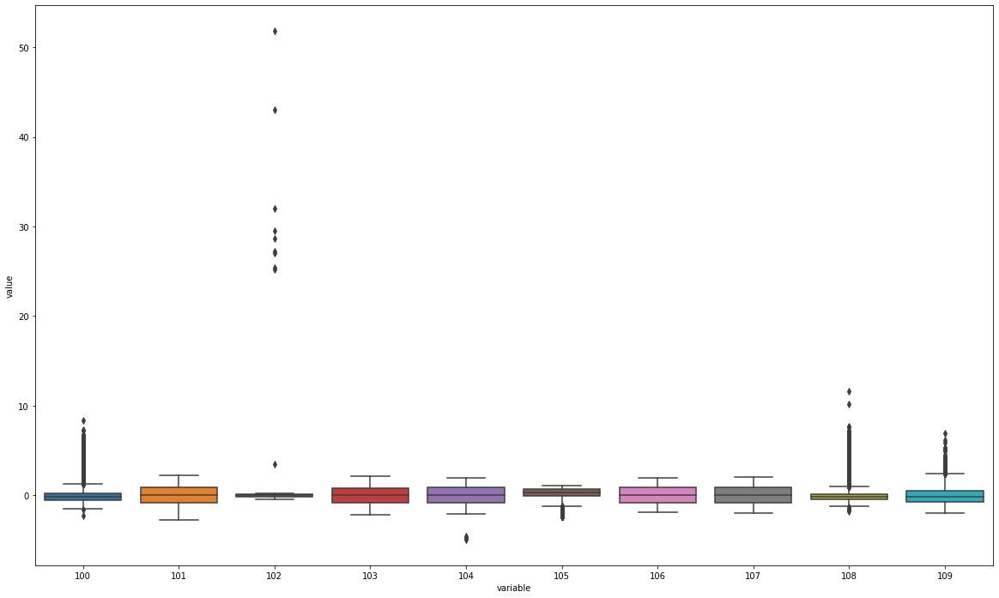

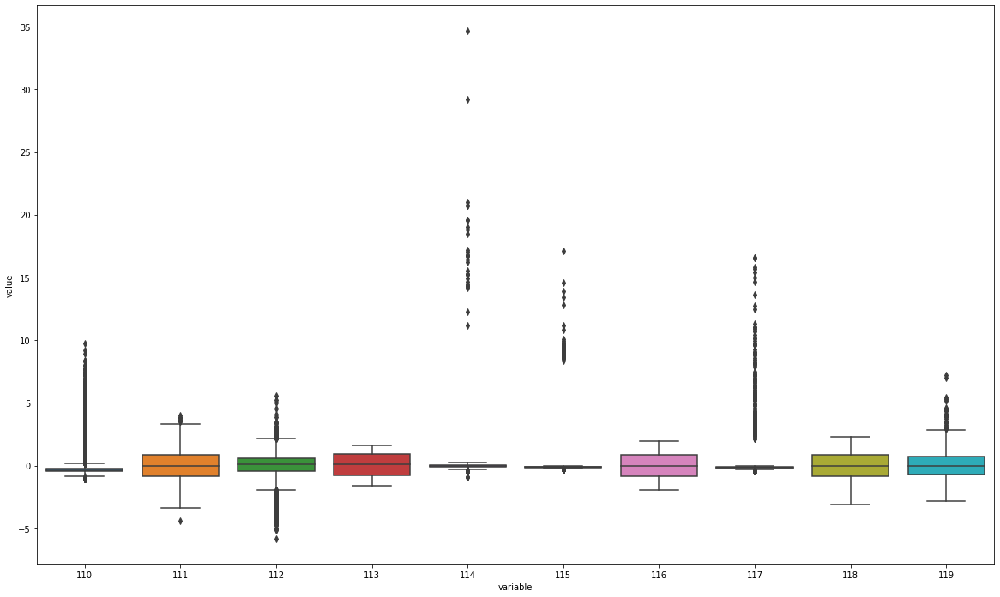

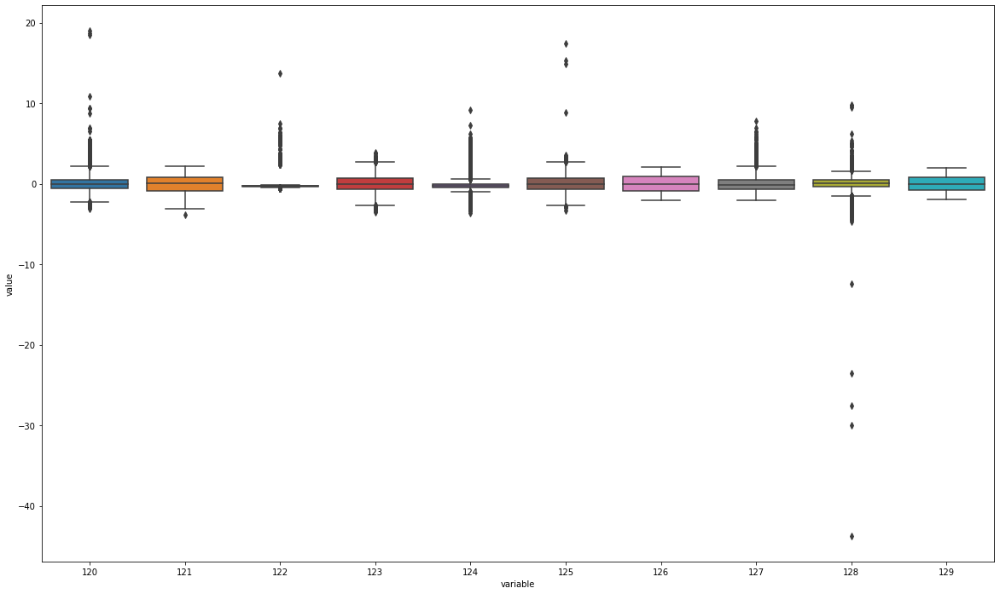

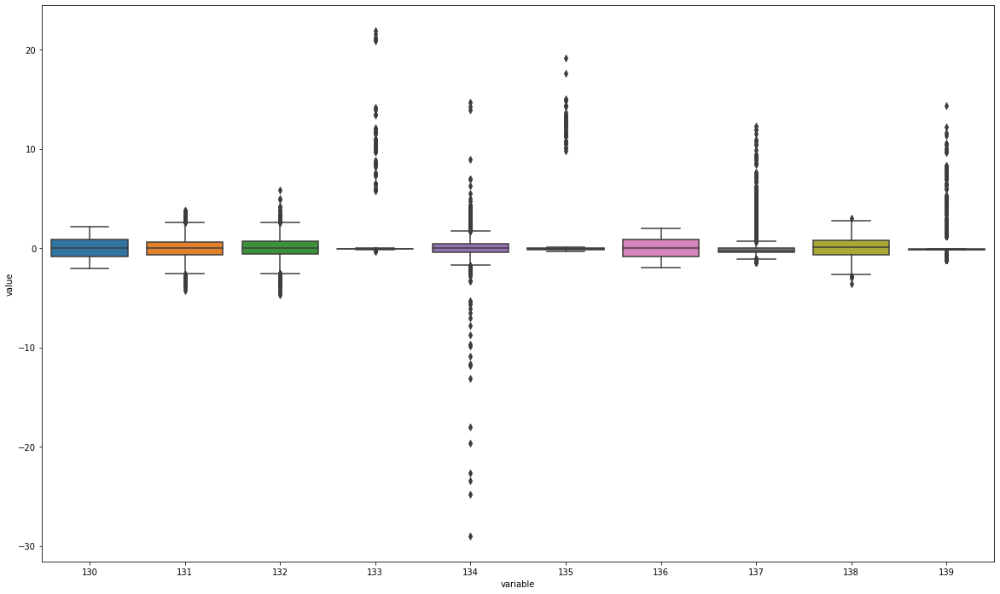

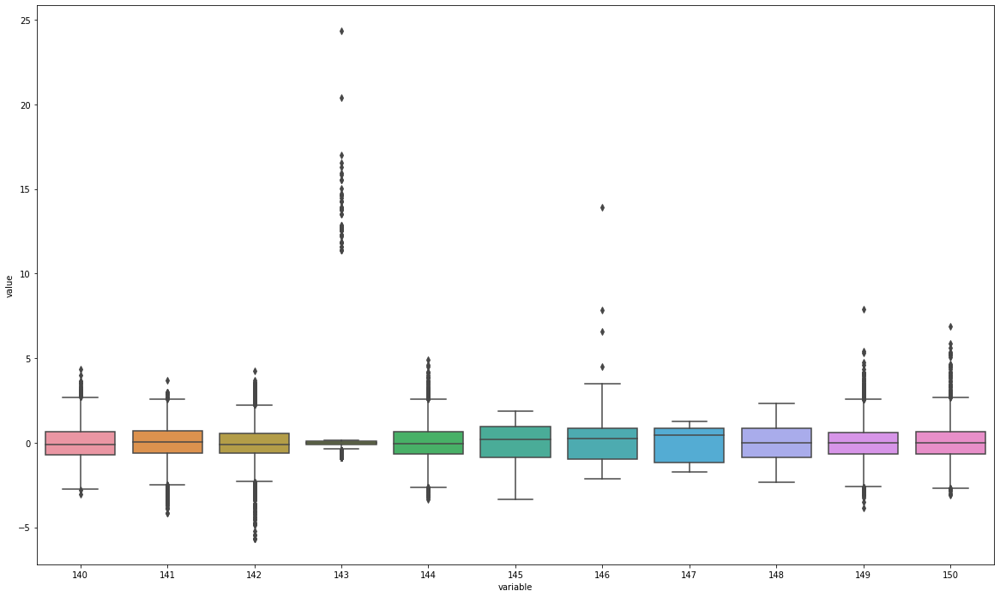

In [8]:
# Box plot for normalized data
start_col = 10
end_col = 20
for col in X.columns[:-8]:
    
    if col == 0:
        plt.figure(figsize=(20,12))
        sns.boxplot(x="variable", y="value", data=pd.melt(X.iloc[:,:col+10]))
        plt.show()
    else: 

        plt.figure(figsize=(20,12))
        try:
            sns.boxplot(x="variable", y="value", data=pd.melt(X.iloc[:,start_col:end_col]))
        except ValueError:
            print(start_col)
            print(end_col)
        start_col = end_col
        end_col = end_col+10
        plt.show()
        if start_col >= 150:
            break
        elif start_col == 140:
            end_col = end_col+12
        

In [9]:
def summary_statistics(data, dtype):
    if dtype == "numerical":
        df_stats_num = data.describe()

        kurtosis_list = []
        skewness_list = []
        numerical_column_list = [col for col in df_stats_num]
        for col in df_stats_num:
            kurtosis_list.append(data[col].kurtosis())
            skewness_list.append(data[col].skew())

        # Generate a dictionary with column and values 
        new_dict_kurtosis = dict(zip(numerical_column_list,kurtosis_list))
        new_dict_skewness = dict(zip(numerical_column_list,skewness_list))

        # Create a series with the index name
        new_rows_kurtosis = pd.Series(data = new_dict_kurtosis, name='kurtosis')
        new_rows_skewness = pd.Series(data = new_dict_skewness, name='skewness')

        # Append the series of kurtosis and skewness to the .describe() dataframe
        df_stats_num = df_stats_num.append(new_rows_kurtosis, ignore_index=False)
        df_stats_num = df_stats_num.append(new_rows_skewness, ignore_index=False)

        if (len(data) > 10):
            df_stats_num = pd.DataFrame(df_stats_num.transpose())
            
        df_stats_num['skewness'] = df_stats_num['skewness'].astype("float64")
            

        df_stats_num.loc[df_stats_num['kurtosis'] < 3 , 'kurtosis type'] = 'Platykurtic' # uniform distribution (thin tails)
        df_stats_num.loc[df_stats_num['kurtosis'] == 3 , 'kurtosis type'] = 'Normal - Mesokurtic'
        df_stats_num.loc[df_stats_num['kurtosis'] > 3 , 'kurtosis type'] = 'Leptokurtic' # heavy tails
        df_stats_num.loc[df_stats_num['skewness'] < 0, 'skewness type'] = 'Negatively Skewed'
        df_stats_num.loc[df_stats_num['skewness'] == 0, 'skewness type'] = 'Symmetrical'
        df_stats_num.loc[df_stats_num['skewness'] > 0, 'skewness type'] = 'Positively Skewed'
        df_stats_num.loc[(df_stats_num['skewness'] > -0.5) & (df_stats_num['skewness'] < 0.5), 'skewness lvl'] = 'Fairly Symmetrical'
        df_stats_num.loc[(df_stats_num['skewness'] > -1.0) & (df_stats_num['skewness'] < -0.5) , 'skewness lvl'] = 'Moderately Skewed'
        df_stats_num.loc[(df_stats_num['skewness'] > 0.5) & (df_stats_num['skewness'] < 1.0), 'skewness lvl'] = 'Moderately Skewed'
        df_stats_num.loc[(df_stats_num['skewness'] > 1.0) | (df_stats_num['skewness'] < -1.0), 'skewness lvl'] = 'Highly Skewed'
        
        print("Numeric data \n")
        display(df_stats_num)
        return df_stats_num

    elif dtype == "categorical":
        df_stats_cat = data.describe()
        if (len(data) > 10):
            df_stats_cat = pd.DataFrame(df_stats_cat.transpose())
        print("Categorical data \n")
        display(df_stats_cat)
        return df_stats_cat

In [10]:
# Check skewness level for each columns
data_skewness = summary_statistics(data, "numerical")

Numeric data 



,count,mean,std,min,25%,50%,75%,max,kurtosis,skewness,kurtosis type,skewness type,skewness lvl
0,10241.0,0.127977,2.018572,-5.480920,-0.710242,-0.055867,0.694998,57.246035,254.993843,12.789476,Leptokurtic,Positively Skewed,Highly Skewed
1,10241.0,-0.018351,0.597846,-0.442000,-0.179000,-0.113000,-0.076000,8.995000,52.558670,6.226675,Leptokurtic,Positively Skewed,Highly Skewed
2,10241.0,-0.045335,0.637736,-0.647000,-0.303000,-0.261000,-0.196000,5.757000,9.044959,2.919899,Leptokurtic,Positively Skewed,Highly Skewed
3,10241.0,-0.016402,0.953677,-2.989000,-0.773000,-0.028000,0.648000,3.446000,-0.458729,0.075875,Platykurtic,Positively Skewed,Fairly Symmetrical
4,10241.0,0.074057,0.960843,-0.517000,-0.310000,-0.282000,-0.239000,9.443000,12.719860,3.193955,Leptokurtic,Positively Skewed,Highly Skewed
5,10241.0,0.004281,0.749460,-0.501000,-0.190000,-0.126000,-0.078000,14.743000,108.815488,8.278932,Leptokurtic,Positively Skewed,Highly Skewed
6,10241.0,-0.007069,0.781811,-0.585000,-0.310000,-0.278000,-0.239000,13.556000,33.457221,4.095252,Leptokurtic,Positively Skewed,Highly Skewed
7,10241.0,10.162148,1.086576,6.931490,9.364720,10.031200,10.832700,15.187900,0.315289,0.599926,Platykurtic,Positively Skewed,Moderately Skewed
8,10241.0,-0.037253,0.218479,-0.190000,-0.059000,-0.051000,-0.045000,5.189000,221.746129,14.158608,Leptokurtic,Positively Skewed,Highly Skewed
9,10241.0,440.690561,22.920082,373.688000,427.281000,439.011000,451.337000,713.481000,27.779716,3.306208,Leptokurtic,Positively Skewed,Highly Skewed


In [11]:
sym_data = data.loc[:, data.columns.isin(data_skewness[data_skewness["skewness lvl"] == "Fairly Symmetrical"].index)]
mskew_data = data.loc[:, data.columns.isin(data_skewness[data_skewness["skewness lvl"] == "Moderately Skewed"].index)]
hskew_data = data.loc[:, data.columns.isin(data_skewness[data_skewness["skewness lvl"] == "Highly Skewed"].index)]
skew_list = [sym_data, mskew_data, hskew_data]
skew_name = ["Fairly Symmetrical", "Moderately Skewed", "Highly Skewed"]

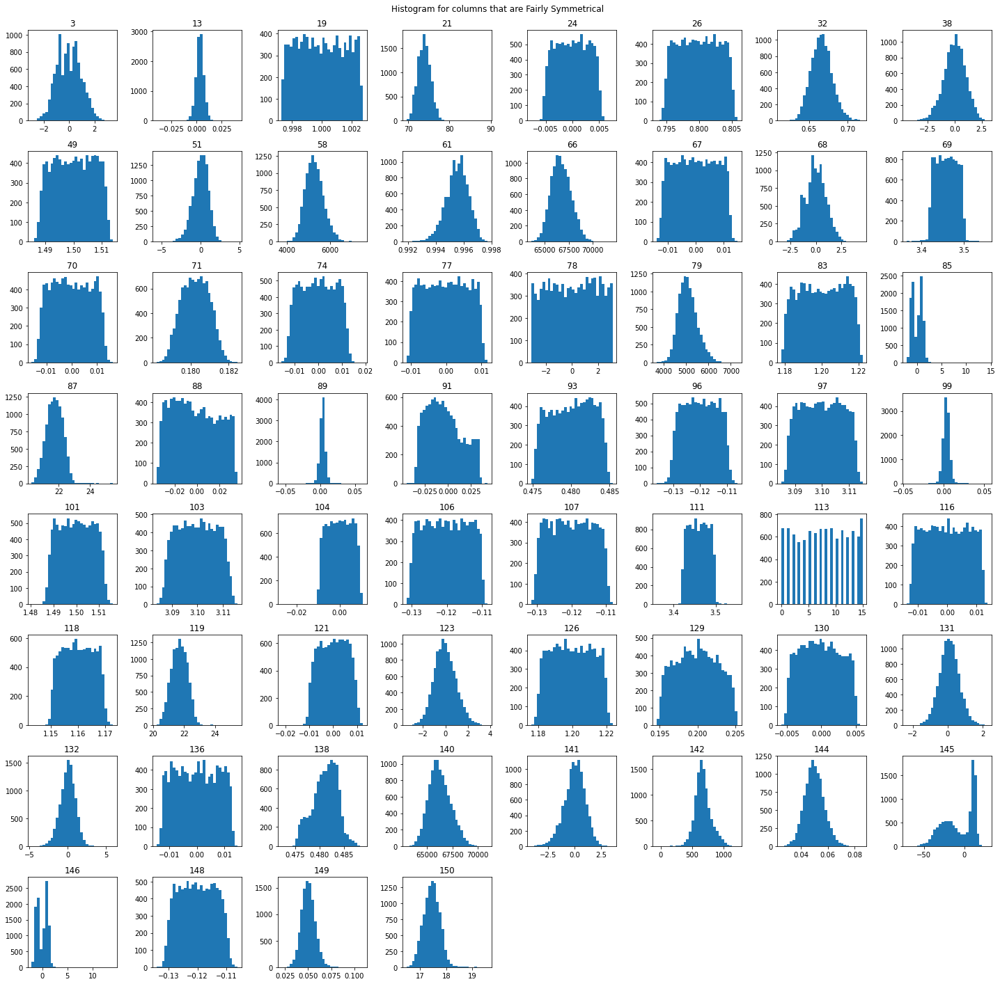

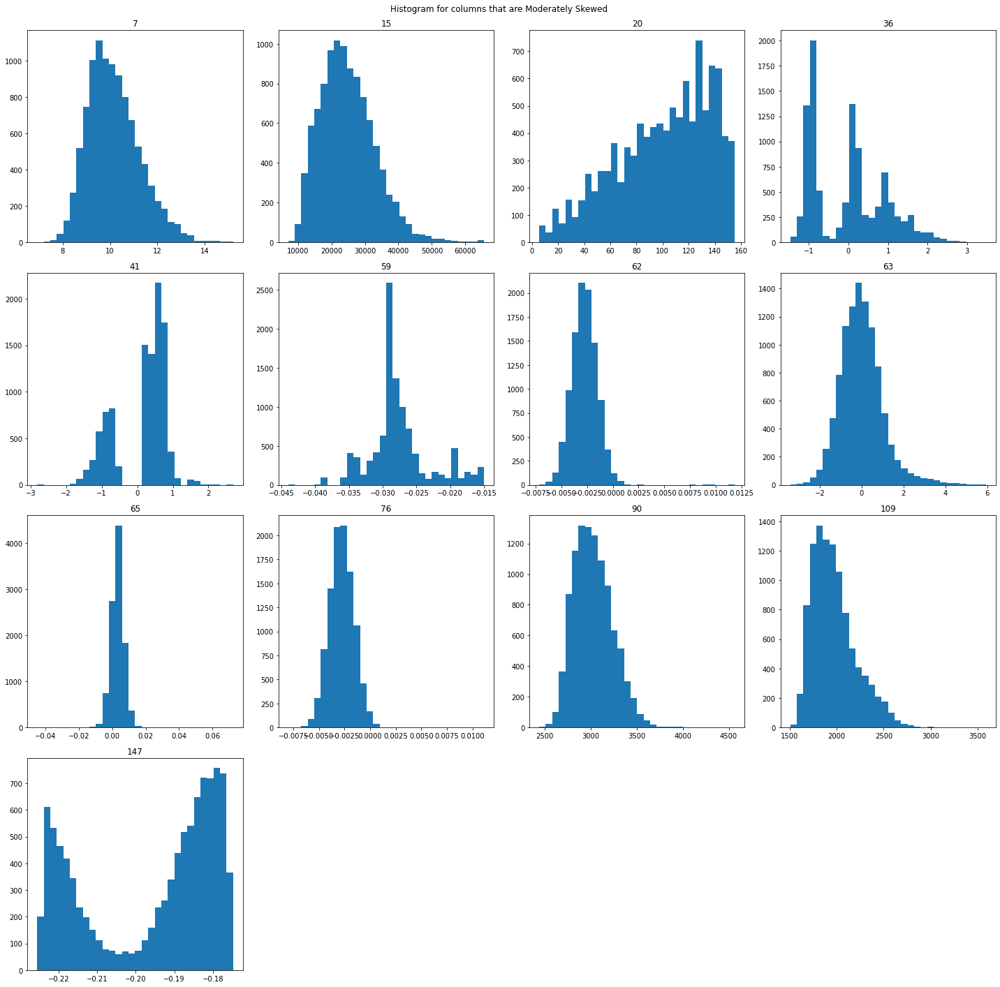

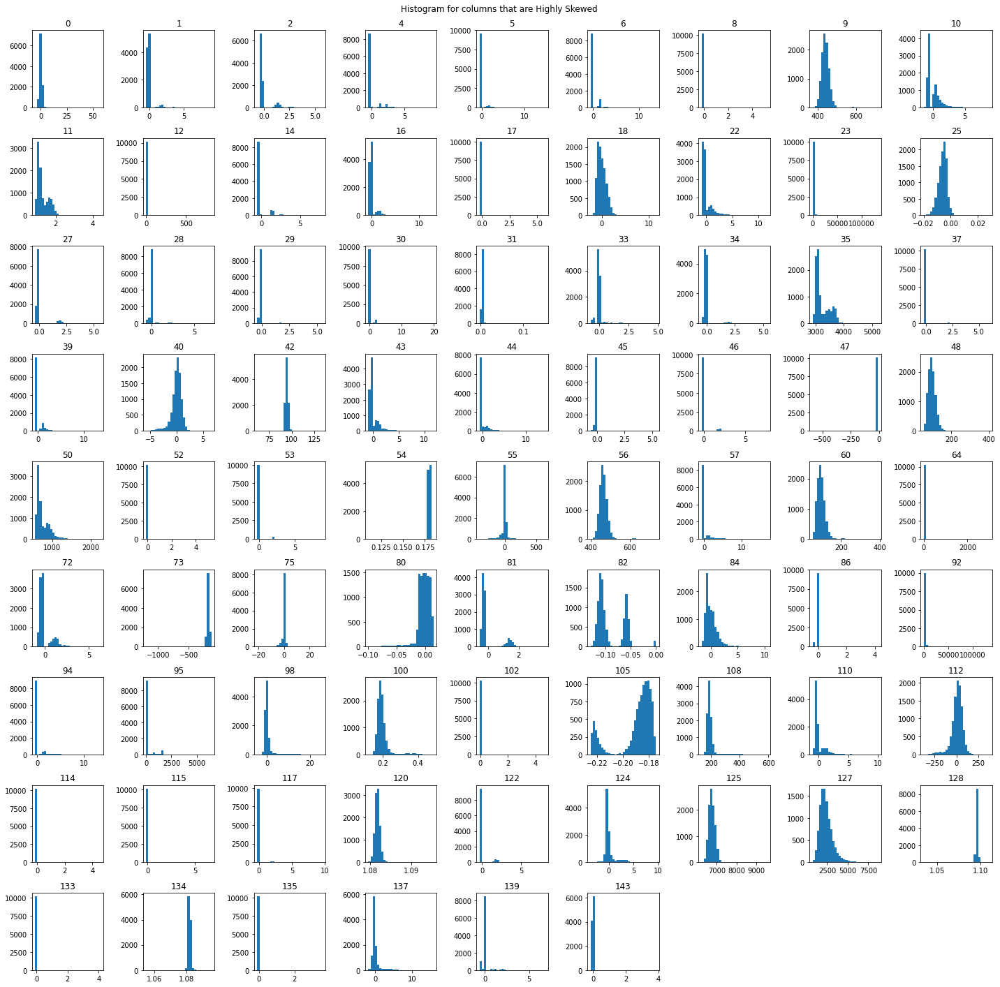

In [12]:
# Histogram for different skewness level to visualize data distributions
for i, skew_df in enumerate(skew_list):
    skew_df.hist(grid=False,figsize=(20, 20),bins=30)
    plt.suptitle("Histogram for columns that are {} \n".format(skew_name[i]))
    plt.tight_layout()
    plt.show()

In [13]:
# Perform sqrt transformation for moderately skewed (Positive)
mpskew_data = mskew_data.loc[:,(mskew_data>0).all()]
mpskew_tdata = mpskew_data.copy()
for col in mpskew_data.columns:
    mpskew_tdata["{}_sqrt".format(col)] = np.sqrt(mpskew_data.loc[:,col])
display(mpskew_tdata)

,7,15,20,90,109,7_sqrt,15_sqrt,20_sqrt,90_sqrt,109_sqrt
0,12.06400,33831,88.184721,3138.67,2052.68,3.473327,183.932053,9.390672,56.023834,45.306512
1,9.92919,13436,133.148294,3536.88,2349.23,3.151062,115.913761,11.538990,59.471674,48.468856
2,11.07720,26894,127.044605,2942.89,2031.26,3.328243,163.993902,11.271407,54.248410,45.069502
3,9.39798,30432,132.809932,2847.29,1707.59,3.065612,174.447700,11.524319,53.360004,41.322996
4,9.42913,14123,105.713099,3327.61,2144.80,3.070689,118.840229,10.281688,57.685440,46.311985
...,...,...,...,...,...,...,...,...,...,...
10236,11.34900,15126,117.101035,3095.54,2134.53,3.368828,122.987804,10.821323,55.637577,46.200974
10237,12.03610,16643,108.339023,2964.17,2137.44,3.469308,129.007752,10.408603,54.444192,46.232456
10238,10.44560,12665,136.123690,3005.72,2088.55,3.231965,112.538882,11.667206,54.824447,45.700656
10239,10.91210,20815,129.487356,2970.58,2140.86,3.303347,144.274045,11.379251,54.503027,46.269428


# Data Transformation

Reference: https://www.marsja.se/transform-skewed-data-using-square-root-log-box-cox-methods-in-python/

In [14]:
# Perform transformation for moderately skewed (Negative)
mnskew_data = mskew_data.loc[:,(mskew_data<0).all()]
mnskew_tdata = mnskew_data.copy()
for col in mnskew_data.columns:
    mnskew_tdata["{}_sqrt".format(col)] = np.sqrt(max(mnskew_data.loc[:, col]+1) - mnskew_data.loc[:, col])
display(mnskew_tdata)

,59,147,59_sqrt,147_sqrt
0,-0.028,-0.18291,1.006479,1.004032
1,-0.025,-0.19030,1.004988,1.007705
2,-0.029,-0.18631,1.006976,1.005724
3,-0.029,-0.19257,1.006976,1.008831
4,-0.019,-0.18187,1.001998,1.003514
...,...,...,...,...
10236,-0.025,-0.18568,1.004988,1.005410
10237,-0.025,-0.21962,1.004988,1.022150
10238,-0.025,-0.18374,1.004988,1.004445
10239,-0.040,-0.18110,1.012423,1.003130


In [15]:
# Perform transformation for highly skewed (Positive)
hpskew_data = hskew_data.loc[:,(hskew_data>0).all()]
hpskew_tdata = hpskew_data.copy()
for col in hpskew_data.columns:
    hpskew_tdata["{}_log".format(col)] = np.log(hpskew_data.loc[:,col])
display(hpskew_tdata)

,9,11,23,35,42,48,50,54,56,60,...,56_log,60_log,92_log,100_log,108_log,120_log,125_log,127_log,128_log,134_log
0,462.092,1.14251,21,3170.06,96.3255,106.7920,704.956,0.178543,515.012,105.2190,...,6.244190,4.656044,3.044522,-1.715204,5.242234,0.077840,8.841257,7.031741,0.088551,0.078192
1,466.645,1.80633,82,3799.00,93.2053,73.7407,966.937,0.180113,482.997,73.1009,...,6.180010,4.291841,4.406719,-1.604764,5.376606,0.078682,8.853038,8.090709,0.091813,0.078155
2,419.784,1.19857,73,3061.70,95.0316,93.0292,683.744,0.179013,448.331,91.8613,...,6.105532,4.520280,4.290459,-1.635520,5.218863,0.078811,8.800100,7.883823,0.091959,0.078636
3,433.346,1.12691,1721,2983.06,93.1631,128.6130,617.283,0.179094,461.617,126.9210,...,6.134736,4.843565,7.451822,-1.496801,5.280148,0.078543,8.820903,7.725771,0.091695,0.078543
4,429.280,1.83109,1713,3733.12,94.1655,74.8545,921.871,0.179362,436.864,74.1023,...,6.079622,4.305447,7.446585,-1.620271,5.140353,0.078229,8.785205,7.750184,0.092059,0.078756
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10236,443.974,1.39763,32,3226.57,93.4722,111.8030,780.525,0.181298,480.886,110.7500,...,6.175630,4.707275,3.465736,-1.766946,5.298202,0.078867,8.842170,7.387090,0.092005,0.078691
10237,450.603,1.25321,33,3198.51,95.5706,88.1768,759.633,0.179009,482.348,87.2787,...,6.178666,4.469106,3.496508,-1.742227,5.294299,0.077813,8.837202,7.454141,0.091831,0.077813
10238,427.511,1.57446,207,3191.70,91.7197,74.6168,783.495,0.180766,446.711,73.9074,...,6.101912,4.302813,5.370638,-1.669183,5.182895,0.078941,8.792911,8.547916,0.092415,0.079116
10239,424.143,1.60250,2273,3206.81,93.0147,97.6933,835.150,0.181021,462.632,95.6647,...,6.136932,4.560849,7.728856,-1.756078,5.340534,0.079347,8.823557,7.670429,0.092980,0.079347


In [16]:
# Perform transformation for highly skewed (Negative)
hnskew_data = hskew_data.loc[:,(hskew_data<0).all()]
hnskew_tdata = hnskew_data.copy()
for col in hnskew_data.columns:
    hnskew_tdata["{}_log".format(col)] = np.log(max(hnskew_data.loc[:, col]+1) - hnskew_data.loc[:, col])
display(hnskew_tdata)

,47,73,105,47_log,73_log,105_log
0,-21.4902,-212.318,-0.18553,2.454138,4.441898,0.010811
1,-18.5995,-171.503,-0.18674,2.168562,3.786936,0.012008
2,-17.8527,-164.190,-0.18328,2.079304,3.605715,0.008583
3,-14.3443,-175.345,-0.18907,1.501964,3.870430,0.014307
4,-16.1362,-161.681,-0.18129,1.837752,3.535116,0.006608
...,...,...,...,...,...,...
10236,-17.5336,-191.514,-0.18945,2.038594,4.160943,0.014682
10237,-19.1495,-194.333,-0.18068,2.229552,4.203961,0.006002
10238,-15.8402,-153.705,-0.18681,1.789490,3.270443,0.012077
10239,-16.1657,-166.259,-0.18569,1.842437,3.660403,0.010970


In [17]:
# Perform transformation for highly skewed (Positive)
hpskew_data = hskew_data.loc[:,(hskew_data>0).all()]
hpskew_btdata = hpskew_data.copy()
for col in hpskew_data.columns:
    hpskew_btdata["{}_boxcox".format(col)] = boxcox(hpskew_data.loc[:,col])[0]
display(hpskew_btdata)

,9,11,23,35,42,48,50,54,56,60,...,56_boxcox,60_boxcox,92_boxcox,100_boxcox,108_boxcox,120_boxcox,125_boxcox,127_boxcox,128_boxcox,134_boxcox
0,462.092,1.14251,21,3170.06,96.3255,106.7920,704.956,0.178543,515.012,105.2190,...,0.193419,2.215179,1.975018,-63.393486,0.227855,0.003234,0.197153,4.122256,7.888718,1.696293
1,466.645,1.80633,82,3799.00,93.2053,73.7407,966.937,0.180113,482.997,73.1009,...,0.193419,2.145960,2.410249,-45.033217,0.227855,0.003234,0.197153,4.419280,9.967063,1.692556
2,419.784,1.19857,73,3061.70,95.0316,93.0292,683.744,0.179013,448.331,91.8613,...,0.193419,2.190464,2.379815,-49.536280,0.227855,0.003234,0.197153,4.365335,10.071876,1.741778
3,433.346,1.12691,1721,2983.06,93.1631,128.6130,617.283,0.179094,461.617,126.9210,...,0.193419,2.247331,2.918111,-32.210559,0.227855,0.003234,0.197153,4.322840,9.882694,1.732206
4,429.280,1.83109,1713,3733.12,94.1655,74.8545,921.871,0.179362,436.864,74.1023,...,0.193419,2.148717,2.917584,-47.250422,0.227855,0.003234,0.197153,4.329478,10.144564,1.754300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10236,443.974,1.39763,32,3226.57,93.4722,111.8030,780.525,0.181298,480.886,110.7500,...,0.193419,2.224187,2.129572,-74.392320,0.227855,0.003234,0.197153,4.227881,10.104852,1.747547
10237,450.603,1.25321,33,3198.51,95.5706,88.1768,759.633,0.179009,482.348,87.2787,...,0.193419,2.180820,2.140096,-68.919095,0.227855,0.003234,0.197153,4.247113,9.980106,1.658359
10238,427.511,1.57446,207,3191.70,91.7197,74.6168,783.495,0.180766,446.711,73.9074,...,0.193419,2.148185,2.624660,-54.978830,0.227855,0.003234,0.197153,4.532037,10.406461,1.792394
10239,424.143,1.60250,2273,3206.81,93.0147,97.6933,835.150,0.181021,462.632,95.6647,...,0.193419,2.197980,2.944819,-71.934566,0.227855,0.003234,0.197153,4.307691,10.836577,1.817236


In [118]:
# Concatenate all data
combined_df = pd.concat([sym_data, 
                         mpskew_tdata.loc[:, mpskew_tdata.columns.str.contains("sqrt")], 
                         mnskew_tdata.loc[:, mnskew_tdata.columns.str.contains("sqrt")], 
                         hpskew_tdata.loc[:, hpskew_tdata.columns.str.contains("log")], 
                         hnskew_tdata.loc[:, hnskew_tdata.columns.str.contains("log")], 
                         data['target']], axis=1)
# combined_df.to_csv("../data/data_transformed.csv", index=False)

In [119]:
combined_df.columns

Index(['3', '13', '19', '21', '24', '26', '32', '38', '49', '51', '58', '61',
       '66', '67', '68', '69', '70', '71', '74', '77', '78', '79', '83', '85',
       '87', '88', '89', '91', '93', '96', '97', '99', '101', '103', '104',
       '106', '107', '111', '113', '116', '118', '119', '121', '123', '126',
       '129', '130', '131', '132', '136', '138', '140', '141', '142', '144',
       '145', '146', '148', '149', '150', '7_sqrt', '15_sqrt', '20_sqrt',
       '90_sqrt', '109_sqrt', '59_sqrt', '147_sqrt', '9_log', '11_log',
       '23_log', '35_log', '42_log', '48_log', '50_log', '54_log', '56_log',
       '60_log', '92_log', '100_log', '108_log', '120_log', '125_log',
       '127_log', '128_log', '134_log', '47_log', '73_log', '105_log',
       'target'],
      dtype='object')

In [19]:
# data is transformed, but still possess skewness in the data,
# for fairly symmetrical data where target is in the majority class, i will remove the outliers from the data
majorclass_df = combined_df.loc[combined_df['target']==0]
display(majorclass_df)

,3,13,19,21,24,26,32,38,49,51,...,108_log,120_log,125_log,127_log,128_log,134_log,47_log,73_log,105_log,target
0,1.022,0.003423,0.997923,74.7715,-0.005000,0.801131,0.66388,-0.686,1.49544,0.351,...,5.242234,0.077840,8.841257,7.031741,0.088551,0.078192,2.454138,4.441898,0.010811,0
1,-0.776,0.004003,1.001320,73.0013,0.000652,0.801101,0.64013,-0.846,1.49699,-0.623,...,5.376606,0.078682,8.853038,8.090709,0.091813,0.078155,2.168562,3.786936,0.012008,0
2,1.099,0.005529,0.997676,74.6132,-0.002503,0.795001,0.67838,-0.204,1.50489,0.031,...,5.218863,0.078811,8.800100,7.883823,0.091959,0.078636,2.079304,3.605715,0.008583,0
3,2.167,0.003243,0.999953,72.9269,0.000661,0.796300,0.67017,0.839,1.50516,0.515,...,5.280148,0.078543,8.820903,7.725771,0.091695,0.078543,1.501964,3.870430,0.014307,0
4,-0.782,0.002859,1.002190,73.3881,0.000866,0.800016,0.66026,-0.609,1.50625,0.729,...,5.140353,0.078229,8.785205,7.750184,0.092059,0.078756,1.837752,3.535116,0.006608,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,0.562,-0.001144,1.001970,75.2403,0.004107,0.802705,0.66268,-0.530,1.48807,-0.461,...,5.634968,0.079292,8.807411,7.070724,0.091886,0.079116,1.738271,3.928526,0.000880,0
9996,0.712,0.000953,0.997338,75.2564,0.002686,0.796954,0.67576,-2.141,1.49865,-0.467,...,5.180012,0.078256,8.822246,7.746733,0.090170,0.078256,1.220977,3.454359,0.013804,0
9997,0.564,0.005524,1.002040,73.6276,-0.000288,0.804246,0.66261,2.068,1.51083,-1.161,...,5.084084,0.078256,8.799258,7.701200,0.092096,0.078256,1.329962,3.068425,0.003105,0
9998,1.119,0.012010,0.997590,76.0266,0.004582,0.803722,0.65641,1.241,1.49693,-0.783,...,5.199971,0.078913,8.794575,7.702104,0.092205,0.079088,2.136094,3.968970,0.004171,0


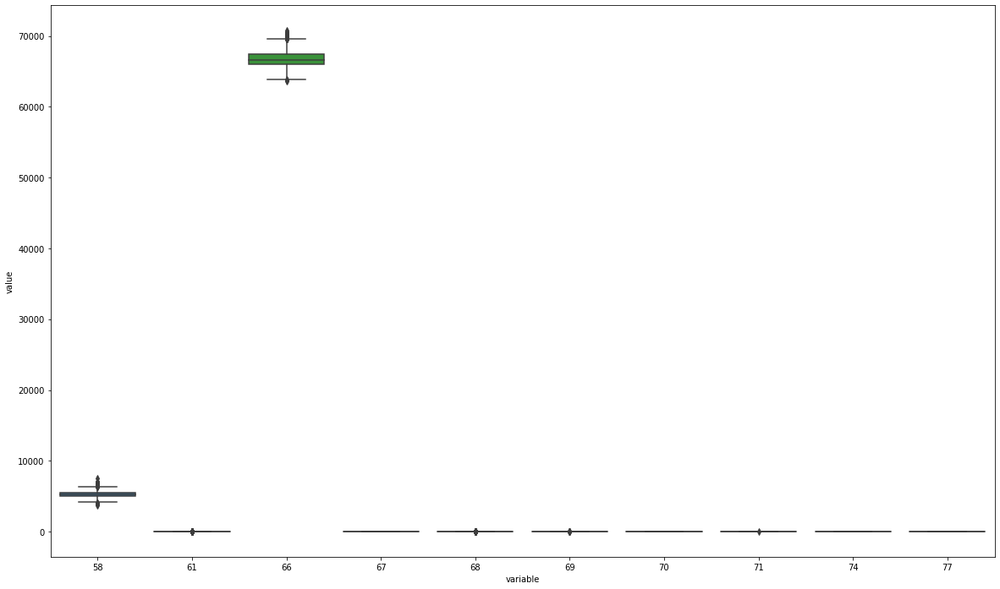

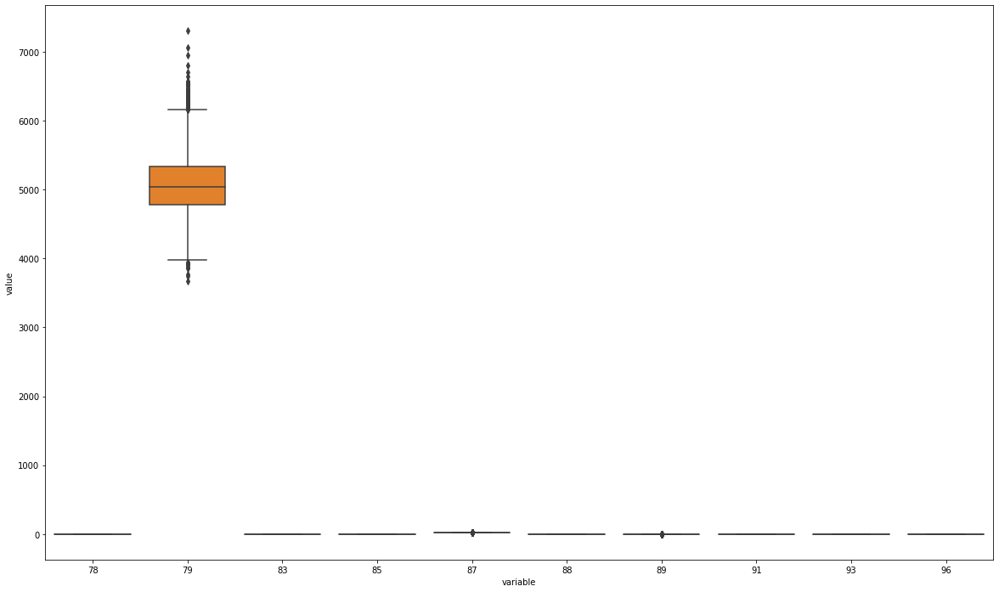

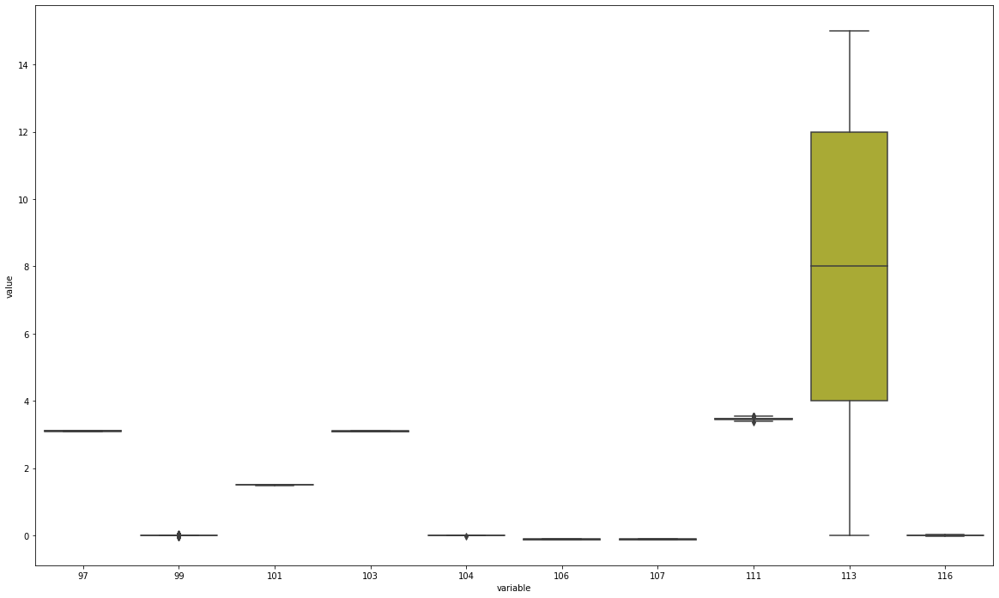

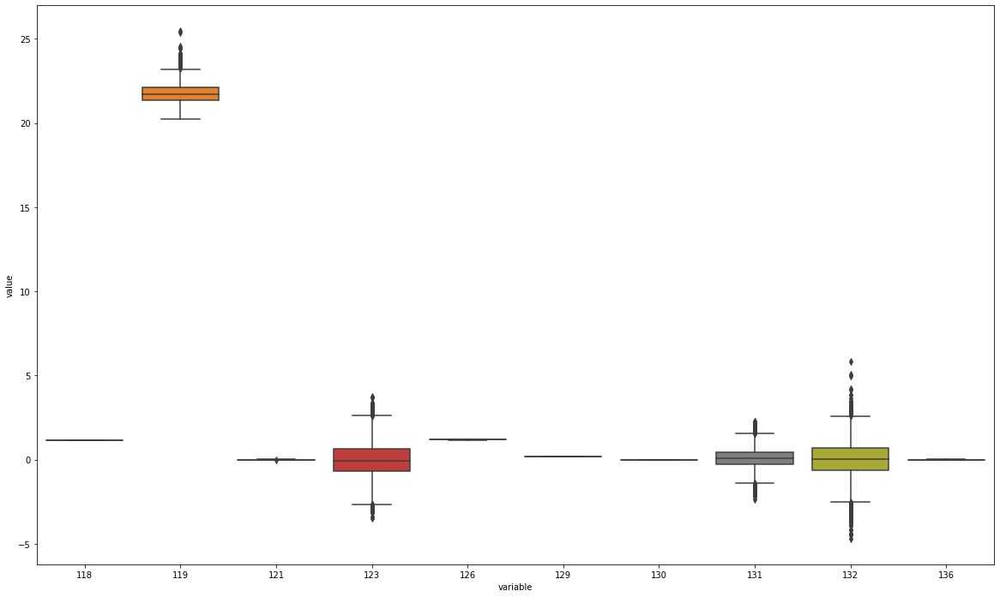

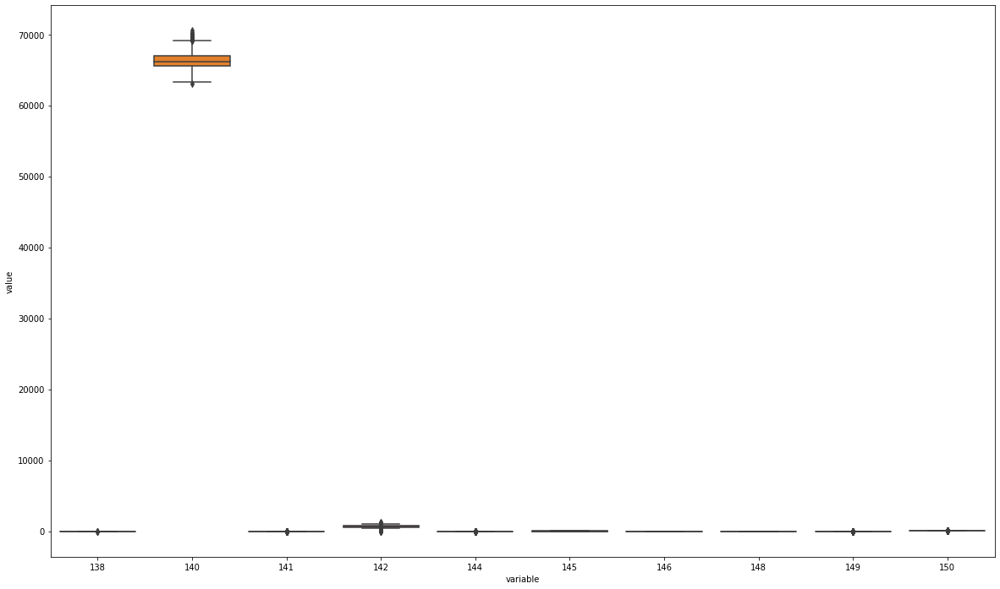

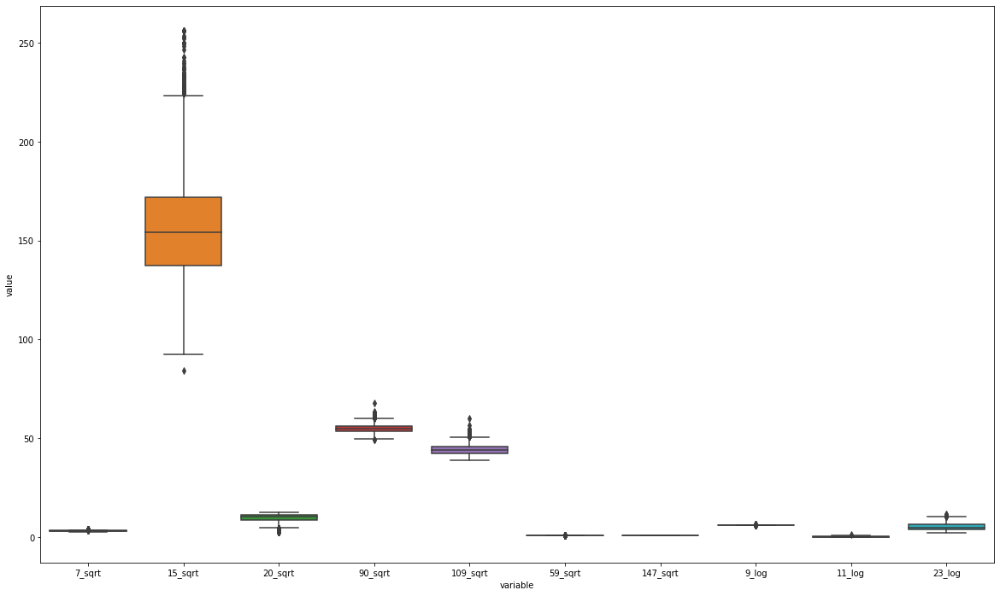

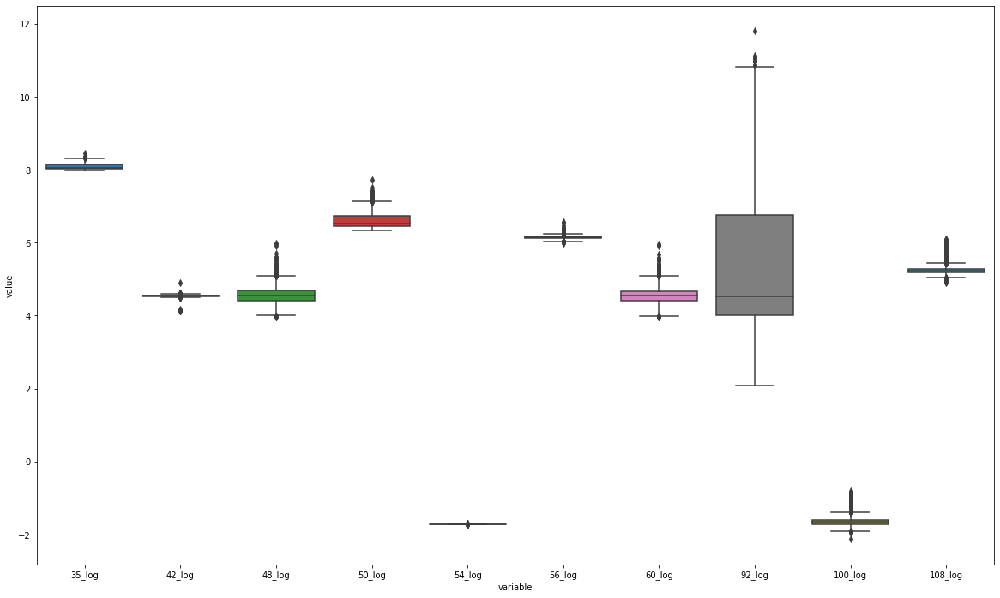

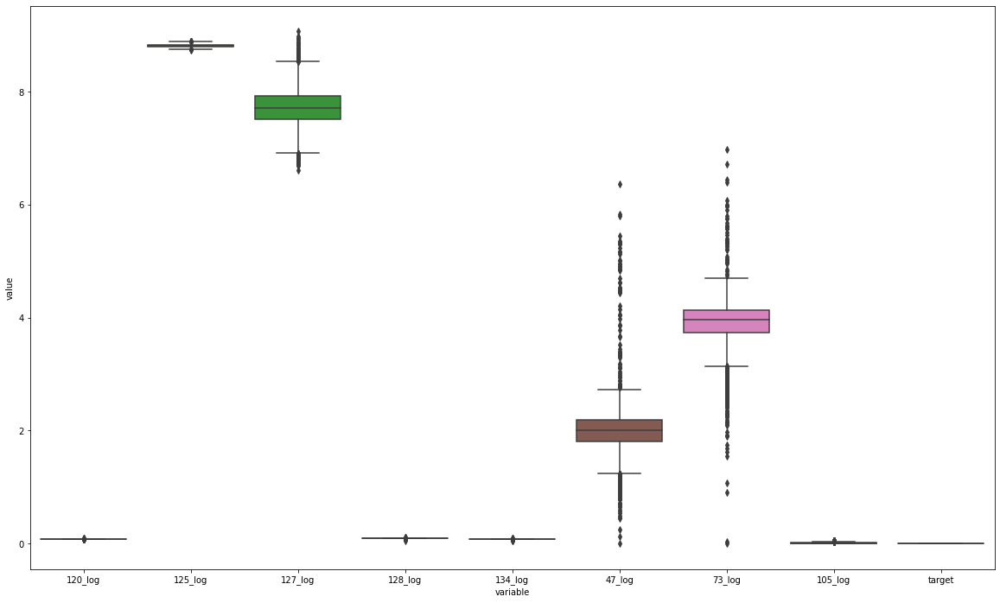

In [20]:
# Box plot for normalized data
start_col = 10
end_col = 20
for col in majorclass_df.columns[:-8]:
    
    if col == 0:
        plt.figure(figsize=(20,12))
        sns.boxplot(x="variable", y="value", data=pd.melt(majorclass_df.iloc[:,:col+10]))
        plt.show()
    else: 

        plt.figure(figsize=(20,12))
        try:
            sns.boxplot(x="variable", y="value", data=pd.melt(majorclass_df.iloc[:,start_col:end_col]))
        except ValueError:
            print(start_col)
            print(end_col)
        start_col = end_col
        end_col = end_col+10
        plt.show()
        if start_col >= 90:
            break
        elif start_col == 80:
            end_col = end_col+12
        

# Outlier Treatment

In [82]:
def remove_outlier(df):
    for col in df.columns[:-1]:
        if "log" not in col and "sqrt" not in col: # only remove outliers from transformed data
            q1 = df[col].quantile(0.25)
            q3 = df[col].quantile(0.75)
            iqr = q3-q1 
            fence_low  = q1-1.5*iqr
            fence_high = q3+1.5*iqr
            df_clean = df.loc[(df[col] > fence_low) & (df[col] < fence_high)]
    return df_clean

In [120]:
major_df = combined_df.loc[combined_df['target']==0]
majortreated_df = remove_outlier(major_df)

In [102]:
print(major_df.shape)
print(majortreated_df.shape)
print("No. of rows removed: {}".format(major_df.shape[0]-(majortreated_df.shape[0])))

(10000, 89)
(9932, 89)
No. of rows removed: 68


In [121]:
minor_df = combined_df.loc[combined_df['target']!=0]

In [122]:
treated_df = pd.concat([majortreated_df, minor_df], axis=0)
treated_df.target.value_counts()

0    9932
1     101
2      59
3      52
4      29
Name: target, dtype: int64

In [123]:
treated_df[:5]

,3,13,19,21,24,26,32,38,49,51,...,108_log,120_log,125_log,127_log,128_log,134_log,47_log,73_log,105_log,target
0,1.022,0.003423,0.997923,74.7715,-0.005000,0.801131,0.66388,-0.686,1.49544,0.351,...,5.242234,0.077840,8.841257,7.031741,0.088551,0.078192,2.454138,4.441898,0.010811,0
1,-0.776,0.004003,1.001320,73.0013,0.000652,0.801101,0.64013,-0.846,1.49699,-0.623,...,5.376606,0.078682,8.853038,8.090709,0.091813,0.078155,2.168562,3.786936,0.012008,0
2,1.099,0.005529,0.997676,74.6132,-0.002503,0.795001,0.67838,-0.204,1.50489,0.031,...,5.218863,0.078811,8.800100,7.883823,0.091959,0.078636,2.079304,3.605715,0.008583,0
3,2.167,0.003243,0.999953,72.9269,0.000661,0.796300,0.67017,0.839,1.50516,0.515,...,5.280148,0.078543,8.820903,7.725771,0.091695,0.078543,1.501964,3.870430,0.014307,0
4,-0.782,0.002859,1.002190,73.3881,0.000866,0.800016,0.66026,-0.609,1.50625,0.729,...,5.140353,0.078229,8.785205,7.750184,0.092059,0.078756,1.837752,3.535116,0.006608,0


In [124]:
treated_df.to_csv("../data/treated_transformed_data.csv", index=False)

In [111]:
# remove outliers on original data
major_df = data.loc[data['target']==0]
majortreated_df = remove_outlier(major_df)

print(major_df.shape)
print(majortreated_df.shape)
print("No. of rows removed: {}".format(major_df.shape[0]-(majortreated_df.shape[0])))

minor_df = data.loc[data['target']!=0]
treated_df = pd.concat([majortreated_df, minor_df], axis=0)
print(treated_df.target.value_counts())
treated_df.to_csv("../data/treated_data.csv", index=False)

(10000, 152)
(9932, 152)
No. of rows removed: 68
0    9932
1     101
2      59
3      52
4      29
Name: target, dtype: int64


# Feature Selection

In [25]:
# For when target is 0, these columns exhibit high variance, and the rest exhibit low variance. 
# Perhaps good idea to remove low variance columns if it doesn't indicate information for the minority classes
vt_data = (majorclass_df[:-1])
thresholder = VarianceThreshold(threshold=.5)
thresholder.fit_transform(vt_data)
high_variance_features = vt_data[vt_data.columns[thresholder.get_support()]].columns
output_data = pd.DataFrame({'features': vt_data.columns, 'variance': thresholder.variances_})
output_data = output_data.sort_values(by= "variance", ascending= False).reset_index(drop = True)
display(output_data)
display(high_variance_features)

,features,variance
0,140,1.145763e+06
1,66,1.044274e+06
2,79,1.745751e+05
3,58,1.737859e+05
4,142,1.646943e+04
5,15_sqrt,6.371096e+02
6,145,3.601803e+02
7,113,2.175878e+01
8,109_sqrt,6.444369e+00
9,20_sqrt,4.023412e+00


Index(['3', '21', '38', '51', '58', '66', '68', '78', '79', '85', '113', '123',
       '132', '140', '141', '142', '145', '146', '15_sqrt', '20_sqrt',
       '90_sqrt', '109_sqrt', '23_log', '92_log'],
      dtype='object')

In [31]:
# check minority classes variance
minorclass_df = combined_df.loc[combined_df['target']!=0]
vt_data = (minorclass_df.loc[:, minorclass_df.columns != 'target'])
thresholder = VarianceThreshold(threshold=.5)
thresholder.fit_transform(vt_data)
high_variance_features = vt_data[vt_data.columns[thresholder.get_support()]].columns
output_data = pd.DataFrame({'features': vt_data.columns, 'variance': thresholder.variances_})
output_data = output_data.sort_values(by= "variance", ascending= False).reset_index(drop = True)
display(output_data)
display(high_variance_features)

,features,variance
0,66,1.069573e+06
1,140,9.649631e+05
2,58,1.963793e+05
3,79,1.954044e+05
4,142,2.345991e+04
5,15_sqrt,5.226049e+02
6,145,4.098791e+02
7,113,2.064892e+01
8,109_sqrt,9.126258e+00
9,90_sqrt,6.231860e+00


Index(['3', '21', '38', '51', '58', '66', '68', '78', '79', '85', '113', '123',
       '132', '140', '141', '142', '145', '146', '15_sqrt', '20_sqrt',
       '90_sqrt', '109_sqrt', '23_log', '92_log', '47_log'],
      dtype='object')

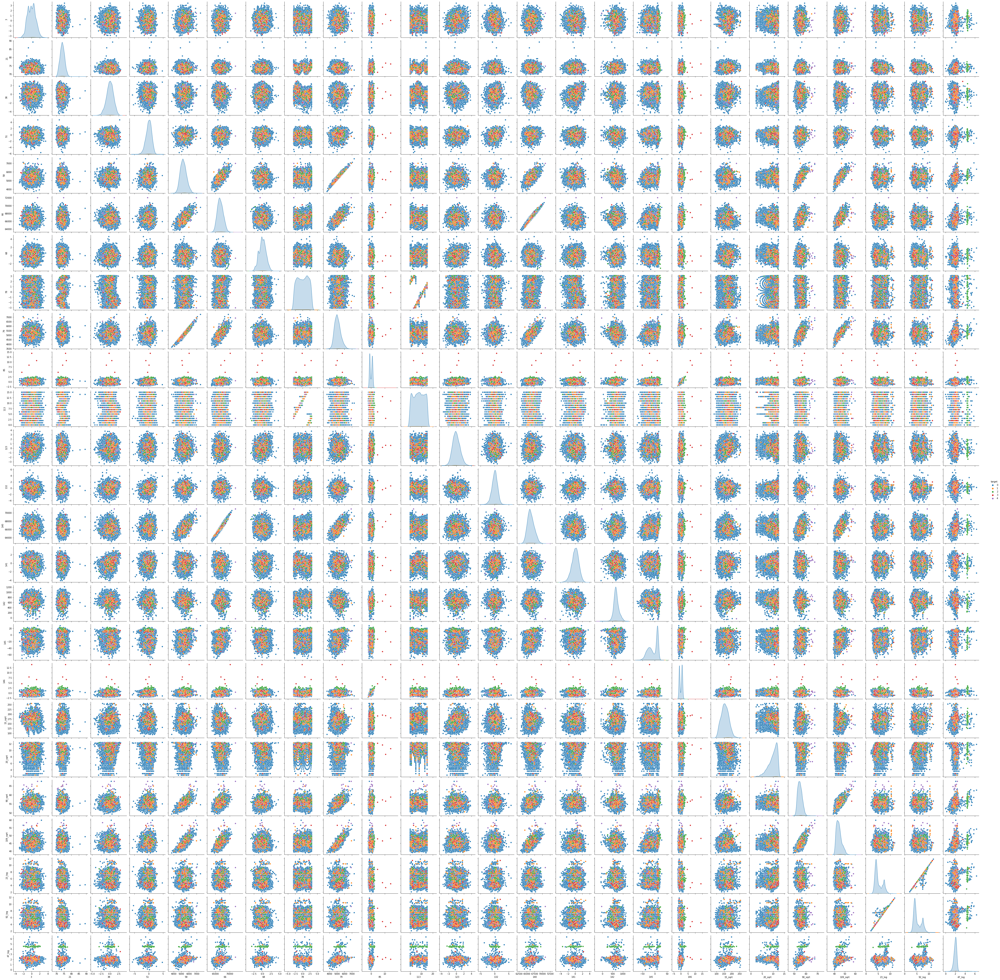

In [33]:
# Let's take a quick glance of pairplot of 15 columns to the target
cols = ['3', '21', '38', '51', '58', '66', '68', '78', '79', '85', '113', '123',
       '132', '140', '141', '142', '145', '146', '15_sqrt', '20_sqrt',
       '90_sqrt', '109_sqrt', '23_log', '92_log', '47_log']
subset1 = pd.concat([combined_df.loc[:, cols], combined_df['target']], axis=1)
sns.pairplot(subset1, hue="target")